In [1]:
using VeryDiff, LinearAlgebra, Plots, Measures
import VeryDiff: approximate_polynomial_iterative

Set parameter Username
Set parameter LicenseID to value 2635085
Gurobi error: ErrorException("Gurobi Error 10009: HostID mismatch (licensed to 4cea64a6, hostid is 7d83c0c0)")
!!! falling back to GLPK !!!


In [2]:
W1 = reshape([1., 1], 2, 1)
b1 = [1, -1.]

W2 = reshape([1, -1.], 1, 2)
b2 = [0.]

1-element Vector{Float64}:
 0.0

In [6]:
nn = Network([Dense(W1, b1), ReLU(), Dense(W2, b2)])

z = Zonotope([-2.], [2.])
degree = 5  # for paper illustration
# degree = 8  # for showing error
nn_poly = approximate_polynomial_iterative(nn, z, degree, cheby=true, verbosity=1, max_iter=20)

--- layer 1 ---
lower = [-2.0]
upper = [2.0]
--- layer 2 ---
lower = [-1.0, -3.0]
upper = [3.0, 1.0]
max error = 0.05859389927906322 at idx 2 with bounds -3.0 1.0
--- layer 3 ---
lower = [-0.7168036647309333, -0.716803664730933]
upper = [3.05859389927633, 1.058593899276329]


Network(Layer[Dense{Float64, Matrix{Float64}, Vector{Float64}}([1.0; 1.0;;], [1.0, -1.0]), VeryDiff.ChebyshevPoly{Float64, SubArray{Float64, 1, Matrix{Float64}, Tuple{Base.Slice{Base.OneTo{Int64}}, Int64}, true}}([1.2159767564769026 1.6093884214893137 … 0.05820314418576433 0.047994435711259525; 0.2159767564769025 0.39061157851068623 … 0.0582031441857642 -0.047994435711259505], [-1.0, -3.0], [3.0, 1.0]), Dense{Float64, Matrix{Float64}, Vector{Float64}}([1.0 -1.0], [0.0])])

In [7]:
xs = range(-2, 2, 200)
ys = [nn([x])[1] for x in xs];
ys_poly = [nn_poly([x])[1] for x in xs];

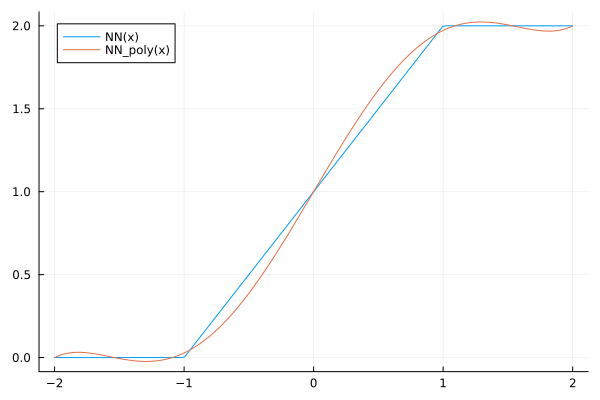

In [8]:
plot(xs, ys, label="NN(x)")
plot!(xs, ys_poly, label="NN_poly(x)")

In [ ]:
idx = 2  # for paper illustration
# idx = 1  # for showing error
cs = nn_poly.layers[2].coeffs[idx,:]
l_approx, u_approx = nn_poly.layers[2].l[idx], nn_poly.layers[2].u[idx]

fc = VeryDiff.make_eval_chebyshev(cs, l_approx, u_approx)

#31 (generic function with 1 method)

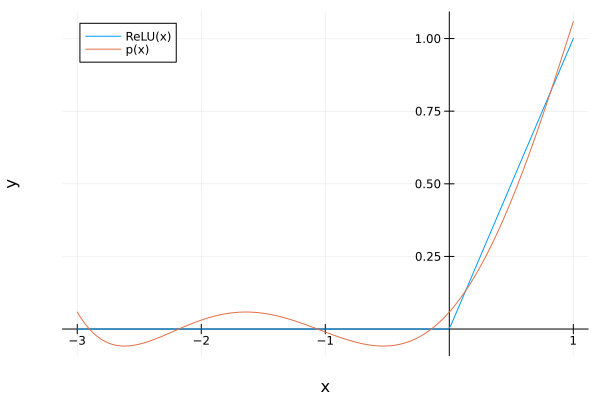

In [16]:
xs = range(l_approx, u_approx, 200)
plot(xs, max.(0, xs), label="ReLU(x)", framestyle=:origin, xlabel="x", ylabel="y")
plot!(xs, fc.(xs), label="p(x)")

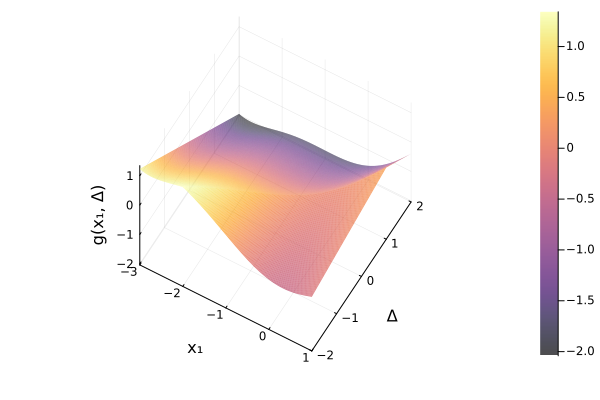

In [17]:
a = -1/7
# b = 1.  # shows error (though without consequences for soundness) for relax_diff_act (for degree=8 and idx=1)
b = 0.8

lΔ, uΔ = -2., 2.

f = (x, Δ) -> fc(x) - max(0, x - Δ) - a*x - b*Δ

xs = range(l_approx, u_approx, 200)
Δs = range(lΔ, uΔ, 200)

# azimuth rotates the (x, Δ) axis 
# (0, 90) is basically a contour plot / heatmap
azimuth = 30.
elevation = 60.
surface(xs, Δs, f, xlabel="x₁", ylabel="Δ", zlabel="g(x₁, Δ)", alpha=0.7, camera=(azimuth, elevation))

In [18]:
ps_leq, ps_geq = VeryDiff.get_boundary_sorted(l_approx, u_approx, lΔ, uΔ)

crit_leq = VeryDiff.relax_diff_inact(ps_leq, VeryDiff.ChebyshevPolynomial(cs, l_approx, u_approx), a, b)
#crit_geq = VeryDiff.relax_diff_act(ps_geq, VeryDiff.ChebyshevPolynomial(cs, l_approx, u_approx), a, b);
crit_geq = VeryDiff.relax_diff_inact(ps_geq, VeryDiff.ChebyshevPolynomial(cs, l_approx, u_approx), (1 + a), (b - 1))

8-element Vector{Tuple{Float64, Float64}}:
 (-2.0, -2.0)
 (1.0, -2.0)
 (1.0, 1.0)
 (-2.0, -2.0)
 (0.32691126945002935, -2.0)
 (1.0, -2.0)
 (1.0, 1.0)
 (0.1527022558733604, 0.1527022558733604)

In [19]:
crit_leq

15-element Vector{Tuple{Float64, Float64}}:
 (-3.0, -2.0)
 (-2.0, -2.0)
 (1.0, 1.0)
 (1.0, 2.0)
 (-3.0, 2.0)
 (-3.0, -2.0)
 (-2.7294794931178776, -2.0)
 (0.1527022558733604, 0.1527022558733604)
 (1.0, 1.0)
 (1.0, 2.0)
 (-2.7294794931178776, 2.0)
 (-1.2299381200820219, 2.0)
 (-0.8658194931788556, 2.0)
 (-3.0, 2.0)
 (-3.0, -2.0)

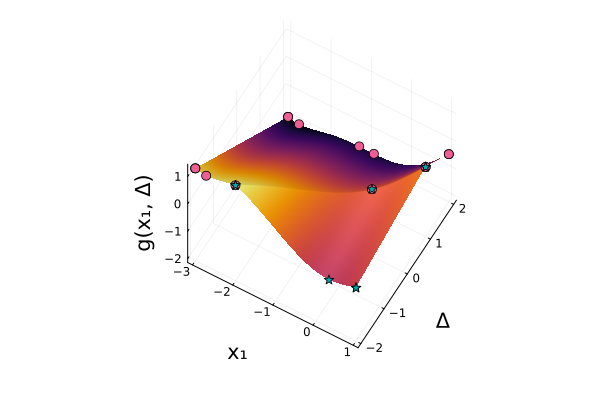

In [20]:
azimuth = 30
elevation = 60
markersize = 5
fontsize = 14
p = surface(xs, Δs, f, xlabel="x₁", ylabel="Δ", zlabel="g(x₁, Δ)", alpha=1, camera=(azimuth, elevation), colorbar=false, 
            xguidefontsize=fontsize, yguidefontsize=fontsize, zguidefontsize=fontsize)
scatter!(first.(crit_leq), last.(crit_leq), f.(first.(crit_leq), last.(crit_leq)), alpha=1, color=7, marker=:circle, markersize=markersize, label=false)  # label="crit inact."
scatter!(first.(crit_geq), last.(crit_geq), f.(first.(crit_geq), last.(crit_geq)), alpha=1, color=6, marker=:star, markersize=markersize, label=false)  # label="crit act."

In [192]:
savefig(p, "unstable_critical_points_all.pdf")

"/home/philipp/VerifyNN/VeryDiffPolyExperiments/running_example/unstable_critical_points_all.pdf"

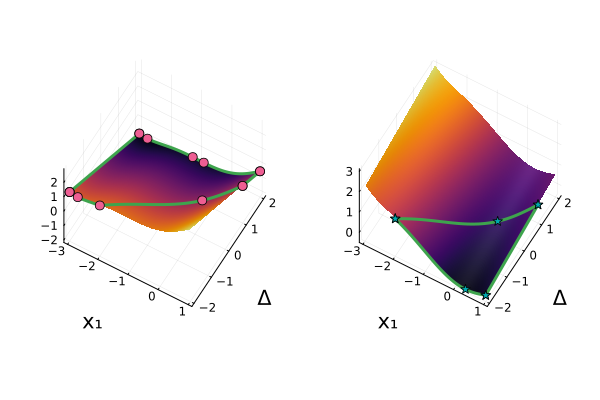

In [21]:
f_leq = (x, Δ) -> fc(x) - a*x - b*Δ
f_geq = (x, Δ) -> fc(x) - (x - Δ) - a*x - b*Δ

f_diag_leq = t -> f_leq(-2 + t, -2 + t)
f_diag_geq = t -> f_geq(-2 + t, -2 + t)
ts = range(0, 3, 100)

# set to (180, 10) to see that the back ones are really the correct critical points
azimuth = 30
elevation = 60
p_leq = surface(xs, Δs, f_leq, xlabel="x₁", ylabel="Δ", alpha=1, camera=(azimuth, elevation), colorbar=false, margin=1mm,
                xguidefontsize=fontsize, yguidefontsize=fontsize, zguidefontsize=fontsize)
# plot boundary
plot!(-2. .+ ts, -2 .+ ts, f_diag_leq.(ts), label=false, color=3, linewidth=3)
bx = range(-3, 1, 100)
plot!(bx, 2 .* ones(100), f_leq.(bx, 2), label=false, color=3, linewidth=3)
bΔ = range(-2, 2, 100)
plot!(-3 .* ones(100), bΔ, f_leq.(-3, bΔ), label=false, color=3, linewidth=3)
bx = range(-3, -2, 100)
plot!(bx, -2 .* ones(100), f_leq.(bx, -2), label=false, color=3, linewidth=3)
bΔ = range(1, 2, 100)
plot!(ones(100), bΔ, f_leq.(1, bΔ), label=false, color=3, linewidth=3)
# plot critical points
scatter!(first.(crit_leq), last.(crit_leq), f.(first.(crit_leq), last.(crit_leq)), label=false, color=7, alpha=1, marker=:circle, markersize=markersize)

azimuth = 30
elevation = 60
p_geq = surface(xs, Δs, f_geq, xlabel="x₁", ylabel="Δ", alpha=1, camera=(azimuth, elevation), colorbar=false,
                xguidefontsize=fontsize, yguidefontsize=fontsize, zguidefontsize=fontsize)
plot!(-2. .+ ts, -2 .+ ts, f_diag_geq.(ts), label=false, color=3, linewidth=3)
bx = range(-2, 1, 100)
plot!(bx, -2 .* ones(100), f_geq.(bx, -2), label=false, color=3, linewidth=3)
bΔ = range(-2, 1, 100)
plot!(ones(100), bΔ, f_geq.(1, bΔ), label=false, color=3, linewidth=3)
scatter!(first.(crit_geq), last.(crit_geq), f.(first.(crit_geq), last.(crit_geq)), color=6, label=false, alpha=1, marker=:star, markersize=markersize)

plot(p_leq, p_geq)

In [196]:
savefig(p_leq, "unstable_critical_points_inact.pdf")
savefig(p_geq, "unstable_critical_points_act.pdf")

"/home/philipp/VerifyNN/VeryDiffPolyExperiments/running_example/unstable_critical_points_act.pdf"

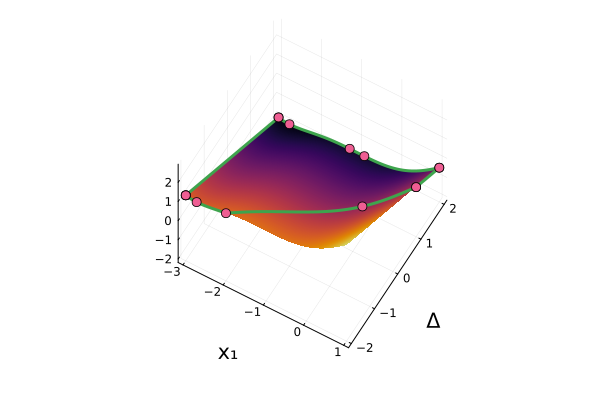

In [22]:
p_leq

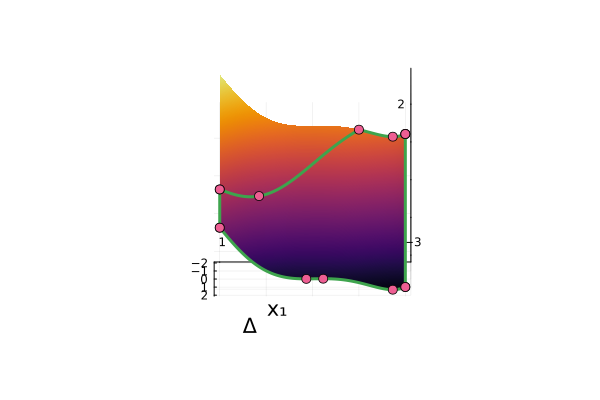

In [23]:
# set to (180, 10) to see that the back ones are really the correct critical points
azimuth = 180
elevation = 10
p_leq = surface(xs, Δs, f_leq, xlabel="x₁", ylabel="Δ", alpha=1, camera=(azimuth, elevation), colorbar=false, margin=1mm,
                xguidefontsize=fontsize, yguidefontsize=fontsize, zguidefontsize=fontsize)
# plot boundary
plot!(-2. .+ ts, -2 .+ ts, f_diag_leq.(ts), label=false, color=3, linewidth=3)
bx = range(-3, 1, 100)
plot!(bx, 2 .* ones(100), f_leq.(bx, 2), label=false, color=3, linewidth=3)
bΔ = range(-2, 2, 100)
plot!(-3 .* ones(100), bΔ, f_leq.(-3, bΔ), label=false, color=3, linewidth=3)
bx = range(-3, -2, 100)
plot!(bx, -2 .* ones(100), f_leq.(bx, -2), label=false, color=3, linewidth=3)
bΔ = range(1, 2, 100)
plot!(ones(100), bΔ, f_leq.(1, bΔ), label=false, color=3, linewidth=3)
# plot critical points
scatter!(first.(crit_leq), last.(crit_leq), f.(first.(crit_leq), last.(crit_leq)), label=false, color=7, alpha=1, marker=:circle, markersize=markersize)

# Example For Specialty of Diagonal

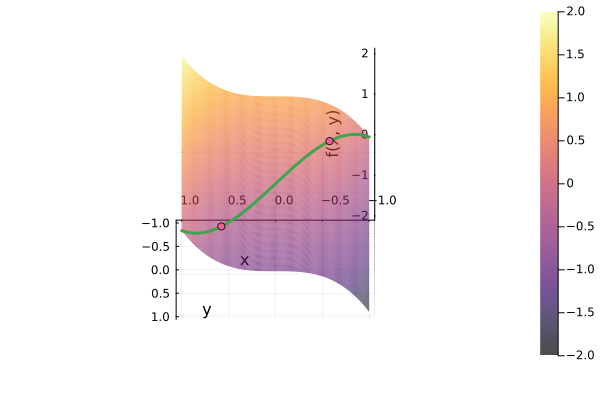

In [33]:
f = (x, y) -> x^3 - y 

lx, ux = -1., 1.
ly, uy = -1., 1.

f_diag = t -> f(lx + t, ly + t)

xs = range(lx, ux, 200)
ys = range(ly, uy, 200)
ts = range(0, ux - lx, 100)

azimuth = 180
elevation = 30
surface(xs, ys, f, xlabel="x", ylabel="y", zlabel="f(x, y)", camera=(azimuth, elevation), alpha=0.7)
plot!(lx .+ ts, ly .+ ts, f_diag.(ts), label=false, color=3, linewidth=3)
scatter!([-sqrt(1/3), sqrt(1/3)], [-sqrt(1/3), sqrt(1/3)], f.([-sqrt(1/3), sqrt(1/3)], [-sqrt(1/3), sqrt(1/3)]), label=false, color=7, alpha=1, marker=:circle)

In [34]:
savefig("diagonal_critical_points.png")

"/home/philipp/VerifyNN/VeryDiffPolyExperiments/running_example/diagonal_critical_points.png"

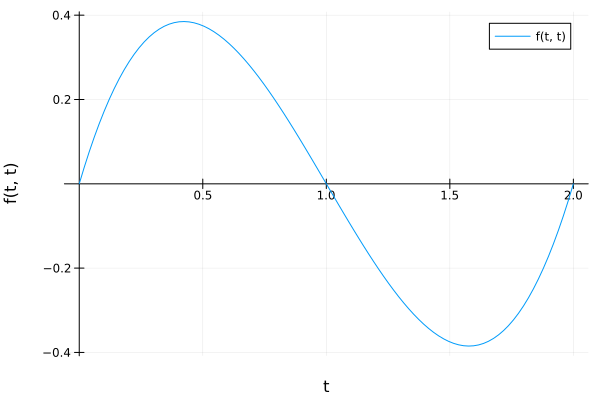

In [30]:
plot(ts, f_diag.(ts), label="f(t, t)", xlabel="t", ylabel="f(t, t)", framestyle=:origin, legend=:topright)